<a href="https://colab.research.google.com/github/cavendano01/IRTM/blob/main/Image_processing.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Contando Hojas de pasto
• Objetivo general: Hacer un Estimado de la cantidad de tallos de grama que hay en sus
jardines.

## Plano detallado de su jardin
plano completo de 8 pies por 5 de ancho 40 pies cuadrados


In [57]:
from google.colab.patches import cv2_imshow


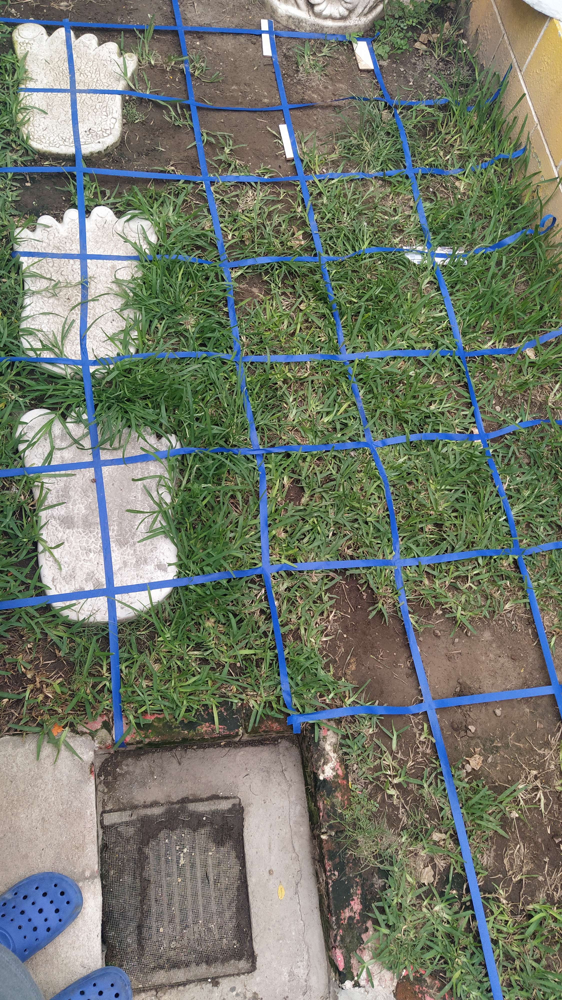

In [75]:
jardin = base + "/all_8x5.jpg"
jardin = cv2.imread(jardin)
cv2_imshow(jardin)

## Metodología a utilizar (abstractamente) – Estartegia


### Librerias a utilizar

In [5]:
import cv2
import matplotlib.pyplot as plt
from skimage import measure
import numpy as np
import pandas as pd
import glob
import os

### Data Loading

In [6]:
#Data Loading
from google.colab import drive
drive.mount('/content/drive/')


Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).


In [7]:
base = '/content/drive/MyDrive/Text-mining&Image-recognition/proyecto/Image_processing/'

### Selección de filtros

Basado en el conteo manual de la imagen de muestra de aproximadamente 250 tallos realice el proceso de selección del mejor conteo que llevo al mejor la imagen gris con histograma ecualizado y el segundo mejor el de gaussian blur.

#### Mejor imagen en escala de grises
Convertimos la imagen a escala de grises ya que de esta manera solamente nos encargamos de un canal para definir cada hoja y remover el background. ya que las hojas tienen overlap entre ellas necesitamos encontrar la mejor forma de convertir ese filtro.

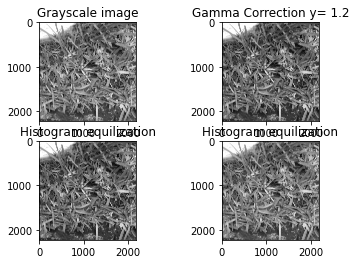

In [20]:
img = cv2.imread(base +'img/1x2.jpg')

# Convert image in grayscale
gray_im = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
plt.subplot(221)
plt.title('Grayscale image')
plt.imshow(gray_im, cmap="gray", vmin=0, vmax=255)

# Contrast adjusting with gamma correction y = 1.2
gray_correct = np.array(255 * (gray_im / 255) ** 1.2 , dtype='uint8')
plt.subplot(222)
plt.title('Gamma Correction y= 1.2')
plt.imshow(gray_correct, cmap="gray", vmin=0, vmax=255)

# Contrast adjusting with histogramm equalization
gray_equ = cv2.equalizeHist(gray_im)
plt.subplot(223)
plt.title('Histogram equilization')
plt.imshow(gray_correct, cmap="gray", vmin=0, vmax=255)

# Gray Scale con Gaussian Blur
gray_gaus = cv2.GaussianBlur(gray_im,(7,7),cv2.BORDER_DEFAULT)
plt.subplot(224)
plt.title('Histogram equilization')
plt.imshow(gray_gaus, cmap="gray", vmin=0, vmax=255)




#### Definición de hojas

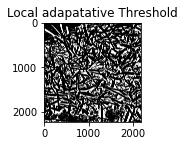

In [21]:
# Local adaptative threshold

thresh = cv2.adaptiveThreshold(gray_gaus, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 255, 19)
thresh = cv2.bitwise_not(thresh)
plt.subplot(221)
plt.title('Local adapatative Threshold')
plt.imshow(thresh, cmap="gray", vmin=0, vmax=255)

#### Selección de kernel de dilatacion y eroción y conteo
Con un kernel de 15x15 el count se quedaba en 2, con uno de 3x3 el count se acercaba a los 250 calculado a mano

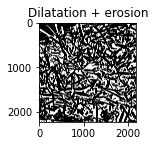

In [22]:
# Dilatation et erosion
kernel = np.ones((12,12), np.uint8)
img_dilation = cv2.dilate(thresh, kernel, iterations=1)
img_erode = cv2.erode(img_dilation,kernel, iterations=1)
# clean all noise after dilatation and erosion
img_erode = cv2.medianBlur(img_erode, 7)
plt.subplot(221)
plt.title('Dilatation + erosion')
plt.imshow(img_erode, cmap="gray", vmin=0, vmax=255)

objects number is: 570


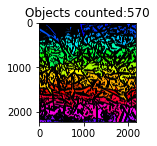

In [23]:
# Labeling

ret, labels = cv2.connectedComponents(img_erode)
label_hue = np.uint8(179 * labels / np.max(labels))
blank_ch = 255 * np.ones_like(label_hue)
labeled_img = cv2.merge([label_hue, blank_ch, blank_ch])
labeled_img = cv2.cvtColor(labeled_img, cv2.COLOR_HSV2BGR)
labeled_img[label_hue == 0] = 0

plt.subplot(222)
plt.title('Objects counted:'+ str(ret-1))
plt.imshow(labeled_img)
print('objects number is:', ret-1)
plt.show()

## Output: Cantidad de tallos de grama en su jardin (puede ser un rango, lo más
pequeño possible).


### Método de Fuerza Bruta
Una sola fotografía se utilizara para medir la cantidad de tallos en todo el jardín de una sola vez.

In [38]:
def leafCounter(img_path):
  imgage = cv2.imread(img_path)
  
  # Convert image in grayscale
  gray_im = cv2.cvtColor(imgage, cv2.COLOR_BGR2GRAY)
  gray = cv2.GaussianBlur(gray_im,(3,3),cv2.BORDER_DEFAULT)
  equalize = cv2.equalizeHist(gray)
  thresh = cv2.adaptiveThreshold(equalize, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 255, 19)
  thresh = cv2.bitwise_not(thresh)
  # Dilatation et erosion
  kernel = np.ones((2,2), np.uint8)
  img_dilation = cv2.dilate(thresh, kernel, iterations=1)
  img_erode = cv2.erode(img_dilation,kernel, iterations=1)
  # clean all noise after dilatation and erosion
  img_erode = cv2.medianBlur(img_erode, 3)
  #Counting
  ret, labels = cv2.connectedComponents(img_erode)
  label_hue = np.uint8(179 * labels / np.max(labels))
  blank_ch = 255 * np.ones_like(label_hue)
  labeled_img = cv2.merge([label_hue, blank_ch, blank_ch])
  labeled_img = cv2.cvtColor(labeled_img, cv2.COLOR_HSV2BGR)
  labeled_img[label_hue == 0] = 0

  plt.subplot(222)
  plt.title('Objects counted:'+ str(ret-1))
  plt.imshow(labeled_img)
  print('objects number is:', ret-1)
  plt.show()
  count = ret-1
  return count


objects number is: 12401


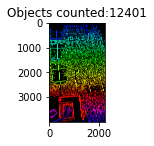

12401

In [39]:
img_path = base +'img/all_8x5.jpg'
leafCounter(img_path)

### Método iterativo
El proceso anterior se realizara en multiples fotografías de areas de 1x1 pies en el cuadrante del jardin, esto contara cada bloque incluyendo aquellos con daño por el perro.

In [73]:
def iterativeCount(img_path):
  arraycounts = []
  arrayIters = []
  arrayAdded = []
  arrayFileName = []
  i=0
  s = 0
  for filename in os.listdir(img_path):
    if filename.endswith(".jpg"):

      
      imgage = cv2.imread(img_path + filename)
      
      # Convert image in grayscale
      gray_im = cv2.cvtColor(imgage, cv2.COLOR_BGR2GRAY)
      gray = cv2.GaussianBlur(gray_im,(3,3),cv2.BORDER_DEFAULT)
      equalize = cv2.equalizeHist(gray)
      thresh = cv2.adaptiveThreshold(equalize, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 255, 19)
      thresh = cv2.bitwise_not(thresh)
      # Dilatation et erosion
      kernel = np.ones((11,11), np.uint8)
      img_dilation = cv2.dilate(thresh, kernel, iterations=1)
      img_erode = cv2.erode(img_dilation,kernel, iterations=1)
      # clean all noise after dilatation and erosion
      img_erode = cv2.medianBlur(img_erode, 7)
      #Counting
      ret, labels = cv2.connectedComponents(img_erode)
      label_hue = np.uint8(179 * labels / np.max(labels))
      blank_ch = 255 * np.ones_like(label_hue)
      labeled_img = cv2.merge([label_hue, blank_ch, blank_ch])
      labeled_img = cv2.cvtColor(labeled_img, cv2.COLOR_HSV2BGR)
      labeled_img[label_hue == 0] = 0
      
      
    s = s + ret-1
    i = i + 1
    arrayFileName.append(filename)
    arrayIters.append(i)
    arraycounts.append(str(ret-1))
    arrayAdded.append(s)

  solution = pd.DataFrame({'Iter':arrayIters,'filename':arrayFileName,'counts':arraycounts, 'running sum':arrayAdded})
  return solution 


In [76]:
img_path = base +'img/'
iterativeCount(img_path)

,Iter,filename,counts,running sum
0,1,5x1.jpg,159,159
1,2,6x1.jpg,92,251
2,3,1x2.jpg,226,477
3,4,1x1.jpg,127,604
4,5,6x4.jpg,52,656
5,6,5x3.jpg,93,749
6,7,8x5.jpg,246,995
7,8,6x3.jpg,34,1029
8,9,8x3.jpg,68,1097
9,10,7x1.jpg,129,1226


## Estimar la cantidad de grama que existe en un campo de golf.

### Método Iterativo promediado (Para inferir)
seleccionando las áreas de menor daño para excluir problemas de covertura se generara un promedio del conteo por iteraciones para poder realizar inferencias basados en pies cuadrados de otras estructuras.

In [77]:
def iterativeAverage(img_path):
  arraycounts = []
  arrayIters = []
  arrayAdded = []
  i=0
  s = 0
  for filename in os.listdir(img_path):
    if filename.endswith(".jpg"):

      
      imgage = cv2.imread(img_path + filename)
      
      # Convert image in grayscale
      gray_im = cv2.cvtColor(imgage, cv2.COLOR_BGR2GRAY)
      gray = cv2.GaussianBlur(gray_im,(3,3),cv2.BORDER_DEFAULT)
      equalize = cv2.equalizeHist(gray)
      thresh = cv2.adaptiveThreshold(equalize, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 255, 19)
      thresh = cv2.bitwise_not(thresh)
      # Dilatation et erosion
      kernel = np.ones((7,7), np.uint8)
      img_dilation = cv2.dilate(thresh, kernel, iterations=1)
      img_erode = cv2.erode(img_dilation,kernel, iterations=1)
      # clean all noise after dilatation and erosion
      img_erode = cv2.medianBlur(img_erode, 7)
      #Counting
      ret, labels = cv2.connectedComponents(img_erode)
      label_hue = np.uint8(179 * labels / np.max(labels))
      blank_ch = 255 * np.ones_like(label_hue)
      labeled_img = cv2.merge([label_hue, blank_ch, blank_ch])
      labeled_img = cv2.cvtColor(labeled_img, cv2.COLOR_HSV2BGR)
      labeled_img[label_hue == 0] = 0
      
      
    s = s + ret-1
    i = i + 1

    arrayIters.append(i)
    arraycounts.append(str(ret-1))
    arrayAdded.append(s)

  average = s / i
  solution = average * i
  
  #pd.DataFrame({'Iter':arrayIters,'counts':arraycounts, 'running sum':arrayAdded})
  return solution , average

In [78]:
img_path = base +'img/'
iterativeAverage(img_path)

(13400.0, 343.5897435897436)

### Promedio de Grama en Golf

Promedio de Grama San Agustin por pie cuadrado = 343.6
Pies Cuadrados en pista de Golf = 
A personal golf green 3,000 square feet. 
normal sized golf green on a course will range from 4,500-
big size 6,500 

In [83]:
def leavesCalculator(average,sqrft):
  solution = average * sqrtft
  return solution

### Average Course 3000 sqft 1,030,800 leaves

In [84]:
average = 343.6
sqrft = 3000
leavesCalculator(average,sqrft)

1030800.0000000001

### Small Course 4,500 sqft 1,546,200 leaves

In [85]:
average = 343.6
sqrtft = 4500
leavesCalculator(average,sqrft)

1546200.0

### Big Course 6,500 sqft 2,233,400 leaves

In [86]:
average = 343.6
sqrtft = 6500
leavesCalculator(average,sqrft)

2233400.0